In [1]:
import pandas as pd
import numpy as np
from sklearn import linear_model
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

**Single Variable Machine Learning Model For  Linear Regression**

Linear regression is a way to identify a relationship between two or more
variables and use these relationships to predict values of one variable for given
value(s) of other variable(s).  
Linear regression assume the relationship between variables can be modelled
through linear equation or an equation of line
  
$ y = m\times x + c$

$\hat y$  is the respective estimate of the y-value. This means that for each x-value the corresponding y-value is estimated. 
![Screenshot 2024-07-03 005447.png](<attachment:Screenshot 2024-07-03 005447.png>)

If all points (measured values) were exactly on one straight line, the estimate would be perfect. However, this is almost never the case and therefore, in most cases a straight line must be found, which is as close as possible to the individual data points. The attempt is thus made to keep the error in the estimation as small as possible so that the distance between the estimated value and the true value is as small as possible. This distance or error is called the "residual", is abbreviated as "e" (error) and can be represented by the greek letter epsilon (ϵ).


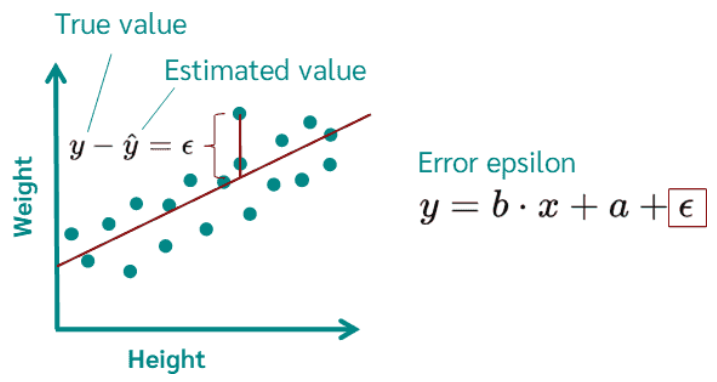

In [2]:
df = pd.read_csv("D:\\Chrome Download\\canada_per_capita_income.csv")
df.head()

,year,per capita income (US$)
0,1970,3399.299037
1,1971,3768.297935
2,1972,4251.175484
3,1973,4804.463248
4,1974,5576.514583


Text(0, 0.5, 'Capital Income(US$)')

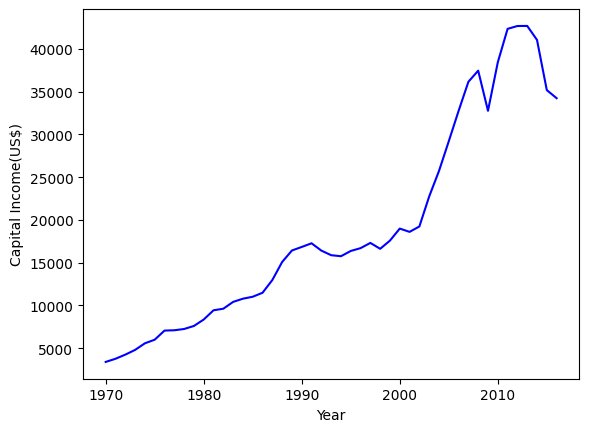

In [3]:
plt.plot(df['year'],df['per capita income (US$)'],'blue')
plt.xlabel("Year")
plt.ylabel("Capital Income(US$)")

In [4]:
#Training Model
reg = linear_model.LinearRegression()
reg.fit(df[['year']],df[['per capita income (US$)']])

LinearRegression()

In [5]:
print("Predicted Income In 2020:",reg.predict([[2020]]))
print("Regression Coef :",reg.coef_)
print("Intercept of Regression:",reg.intercept_)

Predicted Income In 2020: [[41288.69409442]]
Regression Coef : [[828.46507522]]
Intercept of Regression: [-1632210.75785546]


Trained Module saved

In [6]:
import pickle
with open('reg_pickle','wb') as file:
    pickle.dump(reg,file)

In [7]:
with open('reg_pickle','rb') as file:
    mp = pickle.load(file)

In [8]:
mp.predict([[2020]])

array([[41288.69409442]])

**Multiple variables Machine Learning Model For  Linear Regression**

The equation necessary for the calculation of a multiple regression is obtained with k dependent variables as:
  
$ \hat y = b_1\times x + b_2\times x + ....+b_k \times x_k + a $

In [9]:
df_m = pd.read_csv("D:\\Chrome Download\\hiring.csv")
df_m

,experience,test_score(out of 10),interview_score(out of 10),salary($)
0,NaN,8.0,9,50000
1,NaN,8.0,6,45000
2,five,6.0,7,60000
3,two,10.0,10,65000
4,seven,9.0,6,70000
5,three,7.0,10,62000
6,ten,NaN,7,72000
7,eleven,7.0,8,80000


In [10]:
df_m['experience'] = df_m['experience'].fillna("zero")
df_m['test_score(out of 10)'] = df_m['test_score(out of 10)'].fillna(np.mean(df_m['test_score(out of 10)']))
df_m

,experience,test_score(out of 10),interview_score(out of 10),salary($)
0,zero,8.000000,9,50000
1,zero,8.000000,6,45000
2,five,6.000000,7,60000
3,two,10.000000,10,65000
4,seven,9.000000,6,70000
5,three,7.000000,10,62000
6,ten,7.857143,7,72000
7,eleven,7.000000,8,80000


In [11]:
from word2number import w2n
df_m['experience'] = df_m['experience'].apply(w2n.word_to_num) 
df_m

,experience,test_score(out of 10),interview_score(out of 10),salary($)
0,0,8.000000,9,50000
1,0,8.000000,6,45000
2,5,6.000000,7,60000
3,2,10.000000,10,65000
4,7,9.000000,6,70000
5,3,7.000000,10,62000
6,10,7.857143,7,72000
7,11,7.000000,8,80000


In [12]:
reg = linear_model.LinearRegression()
reg.fit(df_m[['experience','test_score(out of 10)','interview_score(out of 10)']],df_m['salary($)'])


LinearRegression()

In [13]:
print("Regression Coef:",reg.coef_)
print("Regression Intecept:",reg.intercept_)

Regression Coef: [2827.63404314 1912.93803053 2196.9753141 ]
Regression Intecept: 17237.330313727172


We will find out the salary of the two candidates.  
First :- 2 yr experience, 9 test score, 6 interview score  
Second :- 12 yr experience, 10 test score, 10 interview score

In [14]:
print("Prediction_1:",reg.predict([[2,9,6]]))
print("Prediction_1:",reg.predict([[12,10,10]]))

Prediction_1: [53290.89255945]
Prediction_1: [92268.07227784]


$\frac{\delta}{\delta m} = \frac{2}{n}\sum_{i=1}^{n}{-x_i}{(y_i - y_{predicted})} $

**Gradient Descent**
It is the method to find best fit to reduce error.In linear regression model error is written as  
mean square error(cost Funtion)   
\begin{align*}
MSE = \frac{1}{n}\sum_{i=1}^{n}{(y_i - y_{predicted})^2}
\end{align*}  

For reduce error we should have minimum values or zero in the partial derivative of m and b 
\begin{align*}
\frac{\delta}{\delta m} = \frac{2}{n}\sum_{i=1}^{n}{-x_i}{(y_i - y_{predicted})} 
\end{align*}

\begin{align*}
\frac{\delta}{\delta b} = \frac{2}{n}\sum_{i=1}^{n}{-(y_i - y_{predicted})} 
\end{align*}

And then m and b will be 

\begin{align*}
m = m - learning rate \times \frac{\delta}{\delta m}
b = b - learning rate \times \frac{\delta}{\delta b}
\end{align*}




In [ ]:
df_g = pd.read_csv("D:\\Chrome Download\\test_scores.csv")
df_g

In [ ]:
rg = linear_model.LinearRegression()
rg.fit(df_g[['math']],df_g.cs)

LinearRegression()

In [ ]:
import math
rg.coef_,rg.intercept_

(array([1.01773624]), 1.9152193111568891)

In [ ]:
#function for gradient descent
def gradient_descent(x,y):
    m_cur = 0
    b_cur = 0
    rate = 0.0002
    n = len(x)
    iteration = 1000000
    mse_pre =0
    
    for i in range(iteration):
        y_pre = m_cur * x + b_cur
        mse = (1/n)*np.sum([val**2 for val in (y - y_pre)])
        dm = -(2/n)*np.sum(x*(y - y_pre))
        db = -(2/n)*np.sum(y - y_pre)
        m_cur = m_cur - rate*dm
        b_cur = b_cur - rate*db
        
        if math.isclose(mse,mse_pre ,rel_tol=1e-20):
            break
        mse_pre = mse
        print("m {},b {},mse {},iteration {}".format(m_cur,b_cur,mse,i))
        
x = np.array(df_g['math'])
y = np.array(df_g['cs'])

gradient_descent(x,y)
    

m 1.9783600000000003,b 0.027960000000000002,mse 5199.1,iteration 0
m 0.2097504127999994,b 0.0030470367999999894,mse 4161.482445460163,iteration 1
m 1.7908456142986249,b 0.02540128695526401,mse 3332.223731926927,iteration 2
m 0.3773816366753042,b 0.005499731626422644,mse 2669.4843523162017,iteration 3
m 1.6409848166378902,b 0.023373894401807944,mse 2139.8263837751483,iteration 4
m 0.5113514173939646,b 0.007477430543482794,mse 1716.5264071567622,iteration 5
m 1.5212165764726313,b 0.02177112969849867,mse 1378.227200780454,iteration 6
m 0.618419142678513,b 0.009075514323270565,mse 1107.8601808918434,iteration 7
m 1.425498156359763,b 0.020507724625171392,mse 891.7842215178462,iteration 8
m 0.7039868810749309,b 0.010370210797388452,mse 719.0974036421321,iteration 9
m 1.3490002310389357,b 0.01951553325074734,mse 581.0869686205018,iteration 10
m 0.7723719384951467,b 0.011422440864086676,mse 470.78972372712883,iteration 11
m 1.2878632281408486,b 0.01874009369115072,mse 382.64072048621694,iterat

**One Hot Encoding**  
we use to represent categorical variables as numerical values in a machine learning model.

In [88]:
df = pd.read_csv("D:\\Chrome Download\\carprices.csv")
df

,Car Model,Mileage,Sell Price($),Age(yrs)
0,BMW X5,69000,18000,6
1,BMW X5,35000,34000,3
2,BMW X5,57000,26100,5
3,BMW X5,22500,40000,2
4,BMW X5,46000,31500,4
5,Audi A5,59000,29400,5
6,Audi A5,52000,32000,5
7,Audi A5,72000,19300,6
8,Audi A5,91000,12000,8
9,Mercedez Benz C class,67000,22000,6


In [89]:
dummy = pd.get_dummies(df['Car Model'])
dummy = dummy.replace({True: 1, False: 0})
dummy

,Audi A5,BMW X5,Mercedez Benz C class
0,0,1,0
1,0,1,0
2,0,1,0
3,0,1,0
4,0,1,0
5,1,0,0
6,1,0,0
7,1,0,0
8,1,0,0
9,0,0,1


Creating dummy for the type of cars where  
Audi A5 = [1,0,0]  
BMW X5 = [0,1,0]  
Mercedez Benz C class = [0,0,1]

In [90]:
#merging the dummy and datafile
new_df1 = pd.concat([df,dummy],axis='columns')
new_df1

,Car Model,Mileage,Sell Price($),Age(yrs),Audi A5,BMW X5,Mercedez Benz C class
0,BMW X5,69000,18000,6,0,1,0
1,BMW X5,35000,34000,3,0,1,0
2,BMW X5,57000,26100,5,0,1,0
3,BMW X5,22500,40000,2,0,1,0
4,BMW X5,46000,31500,4,0,1,0
5,Audi A5,59000,29400,5,1,0,0
6,Audi A5,52000,32000,5,1,0,0
7,Audi A5,72000,19300,6,1,0,0
8,Audi A5,91000,12000,8,1,0,0
9,Mercedez Benz C class,67000,22000,6,0,0,1


In [91]:
#Drop the columns of car model and one multi-colinear variable
new_df = new_df1.drop(['Mercedez Benz C class','Car Model'],axis='columns')
new_df

,Mileage,Sell Price($),Age(yrs),Audi A5,BMW X5
0,69000,18000,6,0,1
1,35000,34000,3,0,1
2,57000,26100,5,0,1
3,22500,40000,2,0,1
4,46000,31500,4,0,1
5,59000,29400,5,1,0
6,52000,32000,5,1,0
7,72000,19300,6,1,0
8,91000,12000,8,1,0
9,67000,22000,6,0,0


In [97]:
#To train the model drop the dependent variable  which is Price of cars
X = new_df.drop(['Sell Price($)'],axis='columns')
X

,Mileage,Age(yrs),Audi A5,BMW X5
0,69000,6,0,1
1,35000,3,0,1
2,57000,5,0,1
3,22500,2,0,1
4,46000,4,0,1
5,59000,5,1,0
6,52000,5,1,0
7,72000,6,1,0
8,91000,8,1,0
9,67000,6,0,0


In [93]:
Y = new_df['Sell Price($)']
Y

0     18000
1     34000
2     26100
3     40000
4     31500
5     29400
6     32000
7     19300
8     12000
9     22000
10    20000
11    21000
12    33000
Name: Sell Price($), dtype: int64

In [98]:
#Training the model
from sklearn.linear_model import LinearRegression
car_price = LinearRegression()
car_price.fit(X,Y)

LinearRegression()

**Questions**  
Q1 - Predict price of a mercedez benz that is 4 yr old with mileage 45000?  
Q2 - Predict price of a BMW X5 that is 7 yr old with mileage 86000?  
Q3 - Tell me the score (accuracy) of your model. (Hint: use LinearRegression().score())?

In [95]:
print("Price of the mercedez benz that is 4yr Old with mileaga 45000:",car_price.predict([[45000,4,0,0]]))
print("Price of the BMW X5 that is 7yr Old with mileaga 86000:",car_price.predict([[86000,7,0,1]]))
print("Accuracy of the model(In Percentage):",car_price.score(X,Y)*100)

Price of the mercedez benz that is 4yr Old with mileaga 45000: [36991.31721061]
Price of the BMW X5 that is 7yr Old with mileaga 86000: [11080.74313219]
Accuracy of the model(In Percentage): 94.17050937281081
